In [2]:
ls

Competiton2.ipynb            input/
README.ipynb                 submission.csv
competition2.code-workspace


In [3]:
pwd

'/Users/makkimaki/PycharmProjects/python_programming/GCIwinter2019/competition2'

In [20]:
import numpy 
import pandas as pd
from pandas import DataFrame, Series
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.metrics import mean_squared_error as MSE

import warnings
warnings.filterwarnings("ignore")

In [5]:
addpath = "./input/"
df = pd.read_csv(addpath + "train.csv")
df_test = pd.read_csv(addpath + "test.csv")

data = pd.concat([df, df_test], sort=False)

In [6]:
df.head()
df_test.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
0,8.1,0.39,0.49,2.3,0.100,47.6,134.4,NaN,3.39,1.00,9.7
1,7.0,0.50,0.49,5.6,0.060,25.8,121.7,0.9891,3.30,0.77,10.7
2,8.1,0.50,0.39,2.5,0.082,12.0,46.0,1.0048,3.38,0.61,10.5
3,6.4,0.38,0.33,3.3,0.046,12.0,52.6,0.9832,3.38,0.63,12.3
4,8.9,0.31,0.46,1.4,0.059,10.9,24.7,0.9931,3.37,0.79,10.2


In [7]:
df.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,1280.00000,1280.000000,1280.000000,1280.000000,1280.000000,1280.000000,1280.000000,1158.000000,1143.000000,1280.000000,1280.000000,1280.000000
mean,8.34125,0.527187,0.271383,2.549766,0.087614,15.599844,45.652812,0.997019,3.309405,0.658953,10.427813,5.614297
std,1.74115,0.181153,0.194353,1.452651,0.049233,10.482150,32.914044,0.010262,0.158249,0.175200,1.065322,0.987628
min,4.70000,0.120000,0.000000,0.900000,0.012000,1.000000,6.000000,0.951600,2.720000,0.330000,8.400000,2.500000
25%,7.10000,0.390000,0.100000,1.900000,0.070000,7.000000,21.675000,0.990300,3.210000,0.550000,9.500000,4.900000
50%,8.00000,0.520000,0.260000,2.200000,0.079000,13.100000,36.800000,0.997350,3.310000,0.620000,10.200000,5.500000
75%,9.30000,0.640000,0.430000,2.600000,0.090250,20.925000,60.350000,1.003500,3.400000,0.730000,11.100000,6.300000
max,15.90000,1.610000,1.000000,15.500000,0.615000,71.800000,290.300000,1.029000,3.970000,2.050000,15.000000,9.700000


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1280 entries, 0 to 1279
Data columns (total 12 columns):
fixed acidity           1280 non-null float64
volatile acidity        1280 non-null float64
citric acid             1280 non-null float64
residual sugar          1280 non-null float64
chlorides               1280 non-null float64
free sulfur dioxide     1280 non-null float64
total sulfur dioxide    1280 non-null float64
density                 1158 non-null float64
pH                      1143 non-null float64
sulphates               1280 non-null float64
alcohol                 1280 non-null float64
quality                 1280 non-null float64
dtypes: float64(12)
memory usage: 120.1 KB


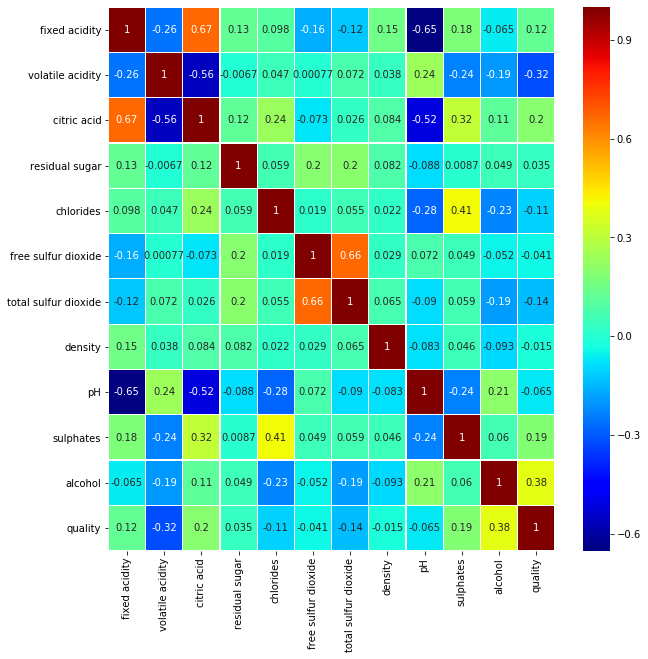

In [9]:
sns.heatmap(df.corr(), annot=True, cmap="jet", linewidth=0.2)
fig = plt.gcf()
fig.set_size_inches(10,10)
plt.show()

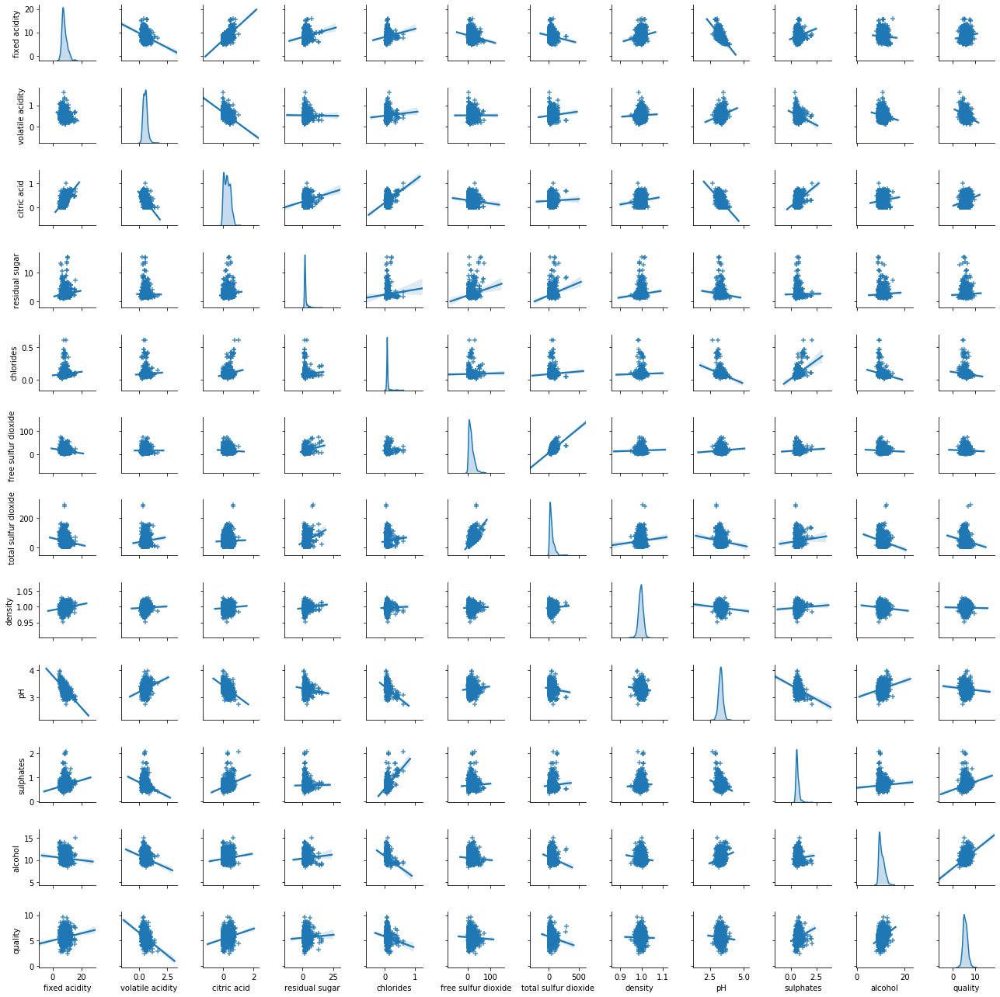

In [10]:
g = sns.pairplot(df, 
                 diag_kind='kde', markers="+", kind="reg",size=1.5)
# g.fig.set_figheight(16)
# g.fig.set_figwidth(16)
# plt.show()

<Figure size 720x720 with 0 Axes>

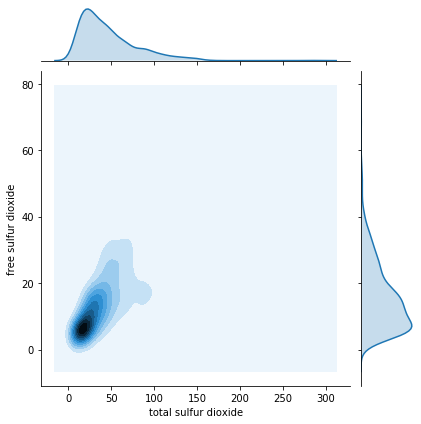

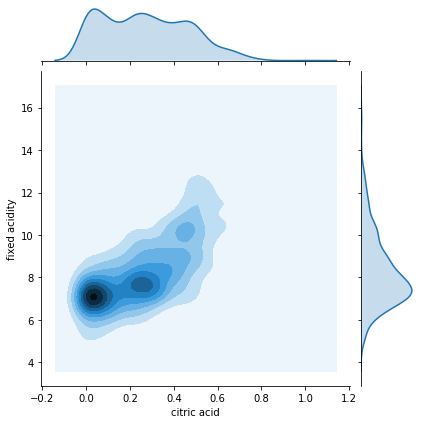

In [11]:
plt.figure(figsize=(10,10))

sns.jointplot(x="total sulfur dioxide", y="free sulfur dioxide", data=data, kind="kde")
sns.jointplot(x="citric acid", y="fixed acidity", data=data, kind="kde")


# plt.show()

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60]),
 <a list of 61 Text xticklabel objects>)

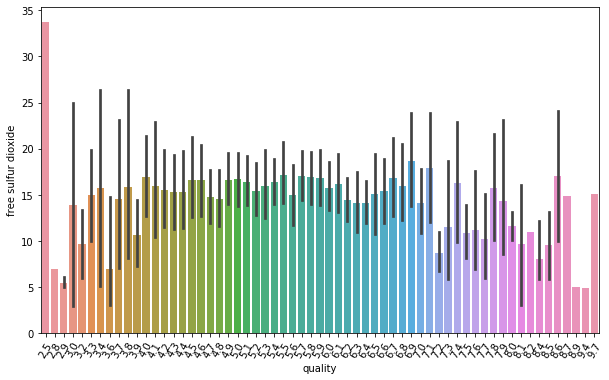

In [12]:
fig = plt.figure(figsize=(10, 6))
sns.barplot(x="quality", y="free sulfur dioxide", data=data)
plt.xticks(rotation=60)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60]),
 <a list of 61 Text xticklabel objects>)

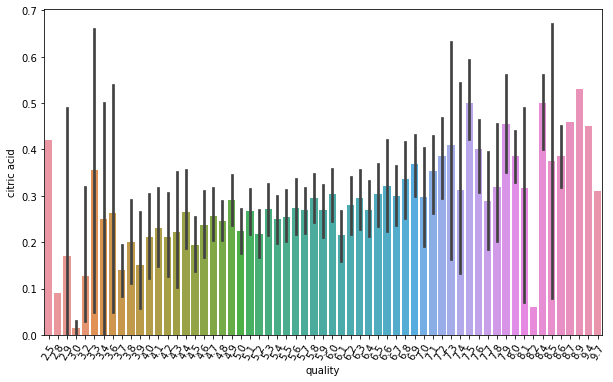

In [13]:
fig = plt.figure(figsize=(10, 6))
sns.barplot(x="quality", y="citric acid", data=data)
plt.xticks(rotation=60)


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60]),
 <a list of 61 Text xticklabel objects>)

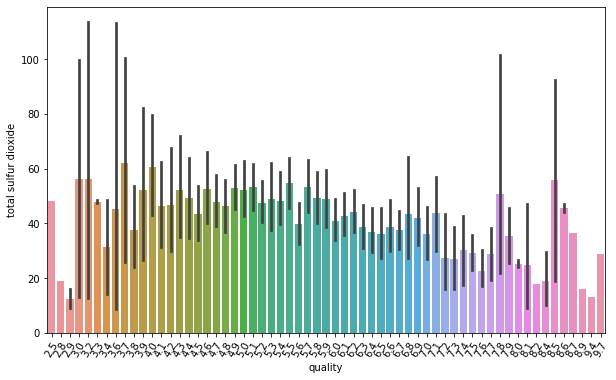

In [14]:
fig = plt.figure(figsize=(10, 6))
sns.barplot(x="quality", y="total sulfur dioxide", data=data)
plt.xticks(rotation=60)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60]),
 <a list of 61 Text xticklabel objects>)

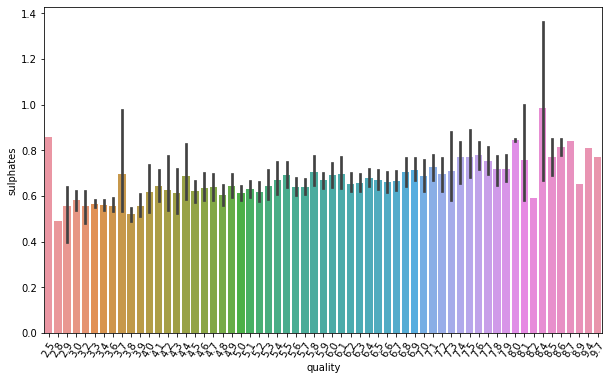

In [15]:
fig = plt.figure(figsize=(10, 6))
sns.barplot(x="quality", y="sulphates", data=data)
plt.xticks(rotation=60)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60]),
 <a list of 61 Text xticklabel objects>)

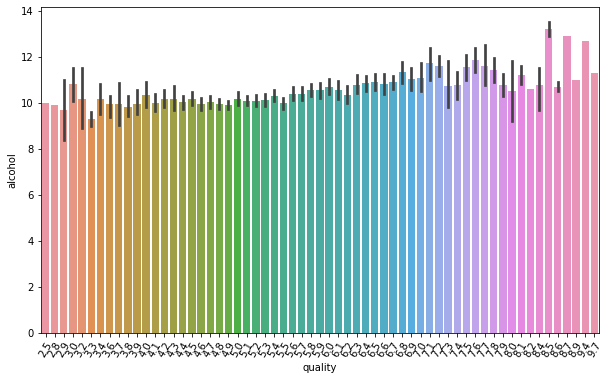

In [16]:
fig = plt.figure(figsize=(10, 6))
sns.barplot(x="quality", y="alcohol", data=data)
plt.xticks(rotation=60)

In [17]:
print('データ型の確認（型変換前）\n{}\n'.format(df.dtypes))

データ型の確認（型変換前）
fixed acidity           float64
volatile acidity        float64
citric acid             float64
residual sugar          float64
chlorides               float64
free sulfur dioxide     float64
total sulfur dioxide    float64
density                 float64
pH                      float64
sulphates               float64
alcohol                 float64
quality                 float64
dtype: object



In [18]:
X = df.drop("quality", axis=1)
y = df["quality"]
X_test = df_test
# y_test = df_test["quality"]

In [21]:
model = LinearRegression()

In [26]:
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.3, random_state=42)
print(X_train.shape)

(896, 11)


In [27]:
model.fit(X_train, y_train)
# y_predict = model.predict(X_valid)
# model.score(y_valid, y_predict)

ValueError: Input contains NaN, infinity or a value too large for dtype('float64').